In [1]:
import os
import numpy as np
import torch
import pickle
from lightglue import LightGlue, SuperPoint, DISK 
from lightglue.utils import load_image, rbd
from lightglue import viz2d
from pathlib import Path
from image_retrieval import most_similar_image
from view_3d_rotate import project_pointcloud_to_query_view
from feature_3d_compute import cache_features, compute_averaged_features

In [2]:
root_dir = Path("megadepth_dataset/MegaDepth_SfM_v1/MegaDepth_v1_SfM/0000")
reference_dir = root_dir / Path("images")
query_dir = reference_dir # TODO: set a query image retrival iterator
# query_dir = Path("datasets/sacre_coeur/query")
# timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
output_dir = Path(f"outputs_retrieval")

images_txt_path = root_dir / Path("sparse/manhattan/1/images.txt")
points3D_txt_path = root_dir / Path("sparse/manhattan/1/points3D.txt")

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
extractor = DISK(max_num_keypoints=5000).eval().to(device)  # load the extractor
matcher = LightGlue(features="disk").eval().to(device)  # load the matcher

[2026/01/16 09:03:11 hloc INFO] Extracting local features with configuration:
{'model': {'name': 'netvlad'},
 'output': 'global-feats-netvlad',
 'preprocessing': {'resize_max': 1024}}
[2026/01/16 09:03:11 hloc.utils.parsers INFO] Imported 12553 images from reference_list.txt


Extracting global features...


[2026/01/16 09:03:17 hloc INFO] Skipping the extraction.
[2026/01/16 09:03:17 hloc INFO] Extracting local features with configuration:
{'model': {'name': 'netvlad'},
 'output': 'global-feats-netvlad',
 'preprocessing': {'resize_max': 1024}}
[2026/01/16 09:03:17 hloc.utils.parsers INFO] Imported 1 images from query_list.txt
[2026/01/16 09:03:24 hloc INFO] Skipping the extraction.
[2026/01/16 09:03:24 hloc INFO] Extracting image pairs from a retrieval database.


Performing image retrieval...


[2026/01/16 09:03:37 hloc.utils.parsers INFO] Imported 12553 images from reference_list.txt
[2026/01/16 09:03:37 hloc.utils.parsers INFO] Imported 1 images from query_list.txt
[2026/01/16 09:03:47 hloc INFO] Found 1 pairs.



The most similar reference image:
2045347627_83e67c94c7_o.jpg
Matched image pair saved: outputs_retrieval/retrieval_result.png


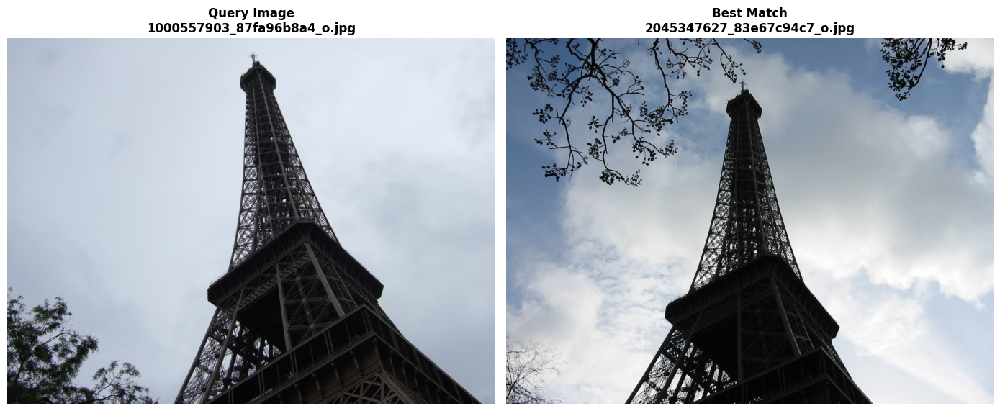

In [3]:
# Retrieve the most similar reference image to the query image
best_match_ref = most_similar_image(reference_dir, query_dir, output_dir)

# Project the 3D point cloud to the best reference image view, and normalize using quantile and sphere normalization
rotate_info = project_pointcloud_to_query_view(images_txt_path, points3D_txt_path, best_match_ref)
points3D_rotated = rotate_info['points_camera']

In [4]:
from view_3d_rotate import load_points3D
from hloc.utils import viz_3d

points3D_original = load_points3D(points3D_txt_path)

fig = viz_3d.init_figure()
viz_3d.plot_points(
    fig, points3D_original, color="rgba(150,150,150,1)", name="3D model"
)
fig.show()

In [5]:
fig = viz_3d.init_figure()
viz_3d.plot_points(
    fig, points3D_rotated, color="rgba(150,150,150,1)", name="3D model"
)
fig.show()

In [6]:
# Cache all reference image features
image_cache = cache_features(images_txt_path, reference_dir, extractor)

5815 images to process in total


100%|██████████| 5815/5815 [14:42<00:00,  6.59it/s]


In [ ]:
with open(output_dir / "image_cache.pkl", "wb") as f:
    pickle.dump(image_cache, f)

In [4]:
with open(output_dir / "image_cache.pkl", "rb") as f:
    image_cache = pickle.load(f)

Computing averaged features for 3D points...


100%|██████████| 461267/461267 [26:19<00:00, 291.94it/s] 


185989 of 461267 3D points get references


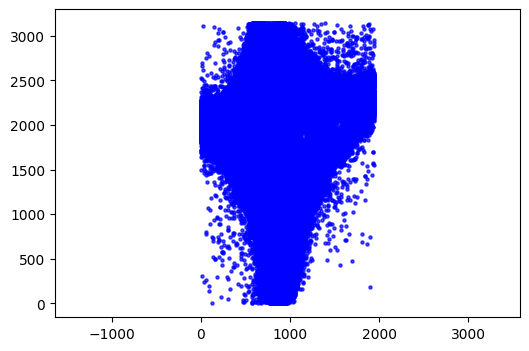

Converted 461267 3D points to virtual image of size 1943x3143.


In [5]:
# Compute averaged 3D point features
points_3D_features = compute_averaged_features(
        points3D_txt_path, images_txt_path, image_cache, points3D_rotated, rotate_info['filter_mask'], descriptor_dim=128
        )

In [6]:
with open(output_dir / "points_3D_features.pkl", "wb") as f:
    pickle.dump(points_3D_features, f)

In [7]:
with open(output_dir / "points_3D_features.pkl", "rb") as f:
    points_3D_features = pickle.load(f)

In [8]:
points_3D_features

{'keypoints': tensor([[[ 816.,  465.],
          [ 752.,  350.],
          [ 846.,  449.],
          ...,
          [1059., 1056.],
          [1069., 1177.],
          [  66., 1880.]]], device='cuda:0'),
 'descriptors': tensor([[[ 0.0000,  0.0000,  0.0000,  ...,  0.0000,  0.0000,  0.0000],
          [ 0.0000,  0.0000,  0.0000,  ...,  0.0000,  0.0000,  0.0000],
          [ 0.0000,  0.0000,  0.0000,  ...,  0.0000,  0.0000,  0.0000],
          ...,
          [-0.0831,  0.0323, -0.0494,  ...,  0.0398, -0.1703,  0.1440],
          [-0.0141, -0.0370, -0.0555,  ...,  0.1390,  0.0018,  0.0203],
          [ 0.0000,  0.0000,  0.0000,  ...,  0.0000,  0.0000,  0.0000]]],
        device='cuda:0'),
 'keypoint_scores': tensor([[ 0.0000,  0.0000,  0.0000,  ..., 59.8529, 87.6691,  0.0000]],
        device='cuda:0'),
 'image_size': tensor([[1943., 3143.]], device='cuda:0')}

In [9]:
with open(output_dir / "query_list.txt", "r") as f:
    query_im = f.readline().strip()

query = load_image(Path(query_dir) / query_im).to(device)
feats_q = extractor.extract(query.to(device))

In [10]:
print(points_3D_features["descriptors"].shape)
print(feats_q["descriptors"].shape)
print(matcher.conf.input_dim)

torch.Size([1, 461267, 128])
torch.Size([1, 3331, 128])
128


In [11]:
def filter_zero_descriptors(point_features):
    # unpack
    keypoints = point_features['keypoints'][0].detach().cpu()          # (1, N, 2)
    descriptors = point_features['descriptors'][0].detach().cpu()      # (1, N, D)
    scores = point_features['keypoint_scores'][0].detach().cpu()       # (1, N)
    image_size = point_features['image_size']        # (1, 2)

    # build valid mask: descriptor not all zeros
    if point_features['keypoints'].shape[1] > 5000:
        valid_mask = (descriptors.abs().sum(dim=1) > 1e-6) & (scores >= sorted(scores, reverse=True)[4999])   # (2048,)
    else:
        valid_mask = descriptors.abs().sum(dim=1) > 1e-6    # (N,)

    print(f"Keeping {valid_mask.sum().item()} / {valid_mask.numel()} points")

    # apply mask
    keypoints = keypoints[valid_mask]
    descriptors = descriptors[valid_mask]
    scores = scores[valid_mask]

    # restore batch dimension
    point_features_filtered = {
        'keypoints': keypoints.unsqueeze(0).to(device),
        'descriptors': descriptors.unsqueeze(0).to(device),
        'keypoint_scores': scores.unsqueeze(0).to(device),
        'image_size': image_size   # unchanged
    }

    return point_features_filtered


In [12]:
points_3D_features = filter_zero_descriptors(points_3D_features)


Keeping 5000 / 461267 points


In [13]:
matches01 = matcher({"image0": points_3D_features, "image1": feats_q})
feats0, feats1, matches01 = [
    rbd(x) for x in [points_3D_features, feats_q, matches01]
]

In [ ]:
kpts0, kpts1, matches = feats0["keypoints"], feats1["keypoints"], matches01["matches"]
m_kpts0, m_kpts1 = kpts0[matches[..., 0]], kpts1[matches[..., 1]]

print(f"{len(m_kpts0)} matched 3D points")

4 matched 3D points
